In [71]:
# COMP 551, Fall 2024, McGill University
# Assignment 2 Tasks 1, 2, 3
# Rob Li, Ian McFarland, Finnley Howald
# 23 October 2024

In [2]:
import numpy as np
import pandas as pd
import itertools
import matplotlib.pyplot as plt

In [3]:
##### Task 1: Linear Regression with Non-Linear Basis Functions

In [4]:
#### 1.1. Data Generation:

In [5]:
# Real relation function
def y_real(x):
  return np.sin(np.sqrt(x)) + np.cos(x) + np.sin(x)

In [73]:
# Generating data points
def random_sample(number_of_samples = 100):
  # 100 random x values as a vector
  x_values = np.random.uniform(0, 20, number_of_samples)
  # Associated real y values
  y_values = y_real(x_values)
  # Adding Gaussian Noise vector
  noise = np.random.normal(0, 1, number_of_samples)
  # Combining
  y_noisy = y_values + noise
  # return
  return x_values, y_noisy

x_sample, y_sample = random_sample(100)

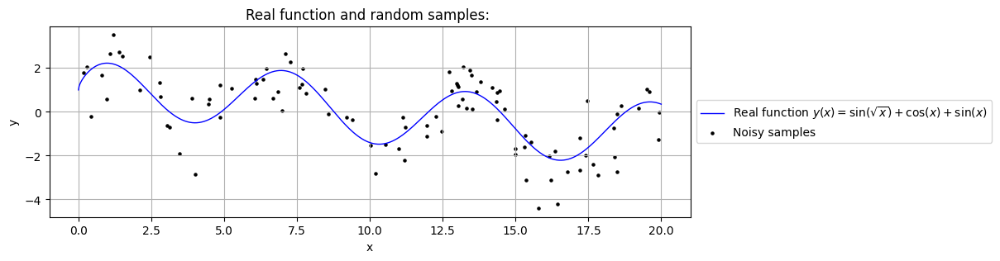

In [74]:
x_real = np.linspace(0, 20, 1000)
y_real_values = y_real(x_real)
plt.figure(figsize=(10, 3))

# Plot the real function
plt.plot(x_real, y_real_values, label="Real function $y(x) = \sin(\sqrt{x}) + \cos(x) + \sin(x)$", color='blue', lw=1)

# Plot the noisy samples
plt.scatter(x_sample, y_sample, label="Noisy samples", color='black', marker='o', s = 5)

# Add titles and labels
plt.title("Real function and random samples: ")
plt.xlabel("x")
plt.ylabel("y")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.grid(True)

# Show plot
plt.show()

In [75]:
#### 1.2. Non Linear Basis Functions

In [76]:
# Gaussian basis function
def gaussian_basis(x, mu, sigma=1.0):
  return np.exp(-0.5 * ((x - mu) / sigma) ** 2)

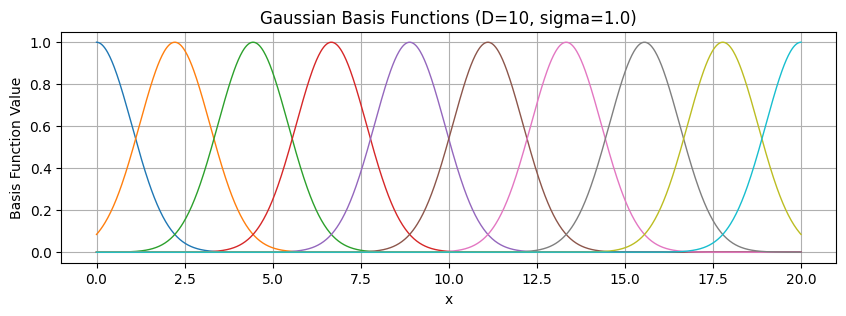

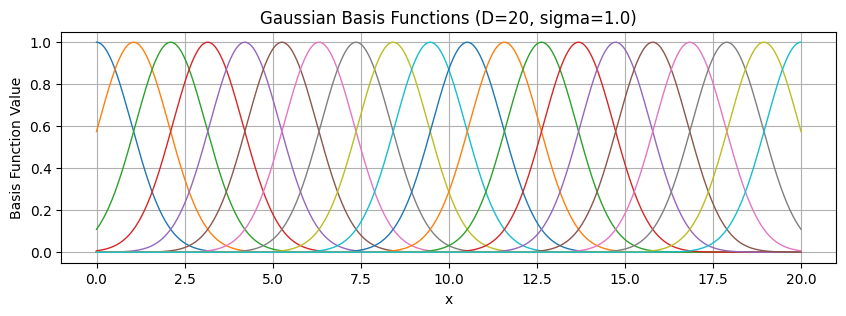

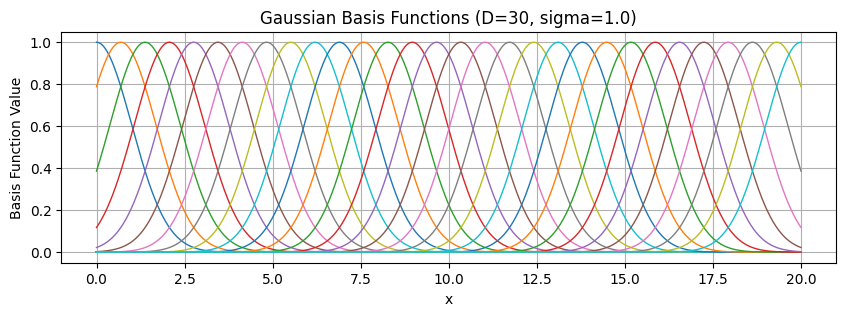

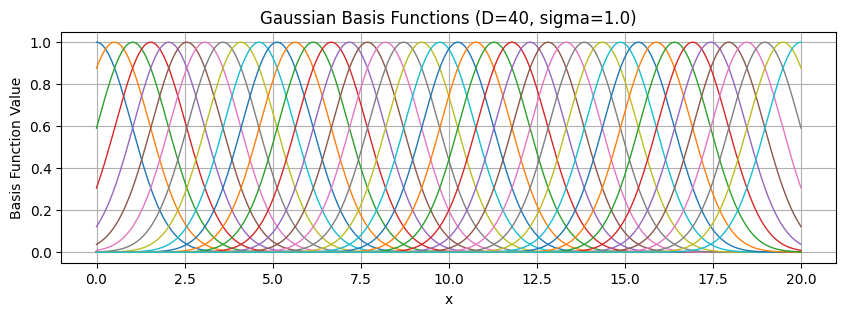

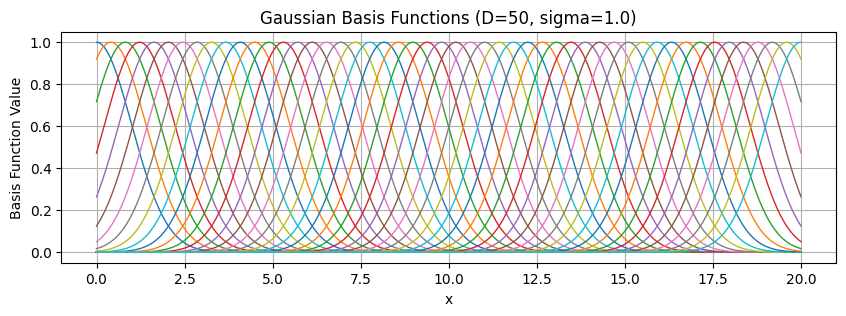

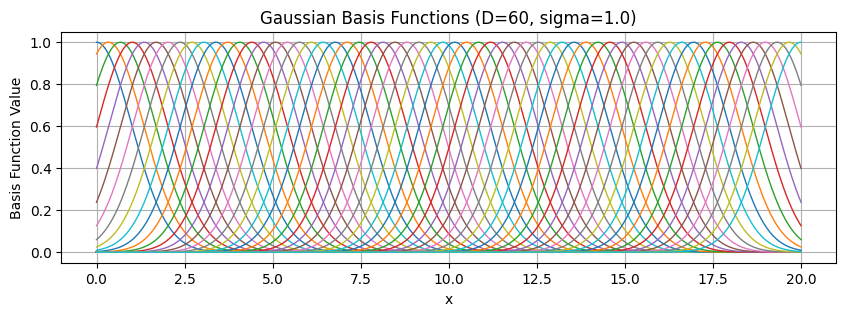

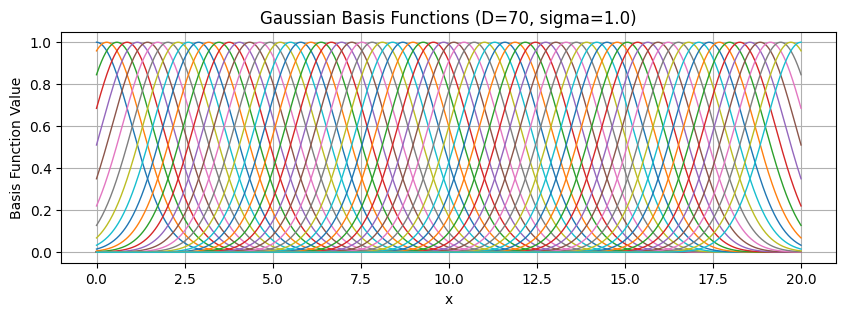

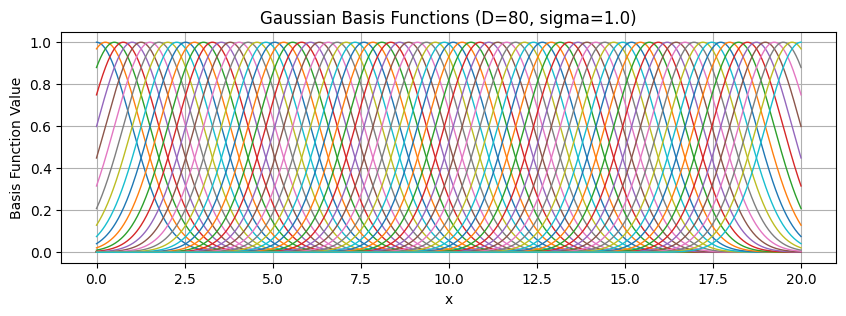

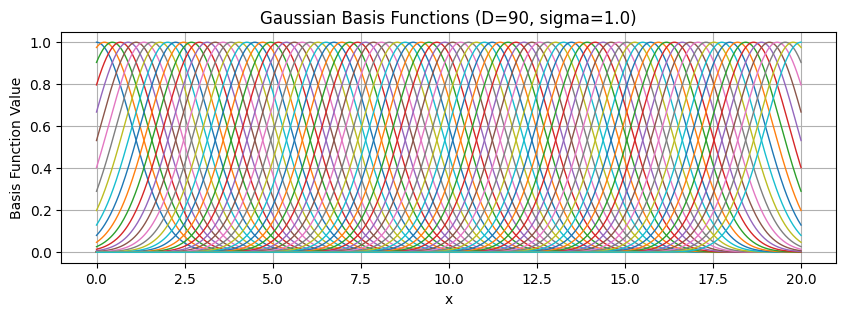

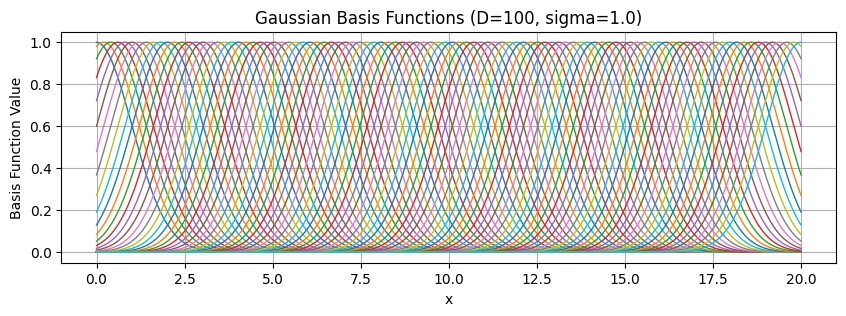

In [77]:
# Plotting the bases
def plot_gaussian_bases(D, x_min=0, x_max=20, sigma=1.0):
  x_values = np.linspace(x_min, x_max, 1000)
  # Defining means for Gaussian basis functions
  means = np.linspace(x_min, x_max, D)
  # Plot the Gaussian basis functions
  plt.figure(figsize=(10, 3))
  for mu in means:
    y_values = gaussian_basis(x_values, mu, sigma)  # Calculate y values for the Gaussian function
    plt.plot(x_values, y_values, lw=1)

  plt.title(f'Gaussian Basis Functions (D={D}, sigma={sigma})')
  plt.xlabel('x')
  plt.ylabel('Basis Function Value')
  plt.grid(True)
  plt.show()

for d in range(10, 101, 10):
  plot_gaussian_bases(d)


In [78]:
#### 1.3. Model Fitting

In [79]:
# Design Matrix
def design_matrix(x_sample, means, standard_variations):
  N = x_sample.shape[0]
  D = len(means)
  design_matrix = np.zeros((N, D))
  for i in range(D):
    design_matrix[:, i] = gaussian_basis(x_sample, means[i], standard_variations)
  return design_matrix

In [80]:
# Linear Regression (analytical solution) class
class LinearRegression:
  def __init__(self, biased = True):
      self.biased = biased
      self.w = None # Our weights for the linear regression

  def fit(self, X, y):
    if X.ndim == 1: # Treats one dimensional case into vector
      X = X[:, None]
    N = X.shape[0] # N = number of samples taken
    if self.biased:
      X = np.column_stack([np.ones(N), X]) # Adds bias column of 1s
    # analytical solution
    self.w = np.linalg.pinv(X.T@X) @ X.T @ y # we get the weights with the closed form matrix solution
    #self.w = np.linalg.lstsq(X, y)[0] # could alternatively by used as suggested by the collab
    return self

  def predict(self, X):
    if X.ndim == 1:
      X = X[:, None]
    if self.biased:
      N = X.shape[0]
      X = np.column_stack([np.ones(N), X])
    y_hat = X @ self.w
    return y_hat

In [81]:
# Fitting sample data with 0, 10, 20, ... 100 gaussians
def fitted_model(x_train, y_train, D = 0, sigma = 1.0):
  if D == 0:
    model = LinearRegression(biased=True)
    model.fit(x_train, y_train)
  else:
    means = np.linspace(0, 20, D)
    phi_matrix = design_matrix(x_train, means, sigma)
    model = LinearRegression(biased=True)
    model.fit(phi_matrix, y_train)
  return model


In [82]:
# Plotting the fits
def plot_models(x_train, y_train, D, sigma=1.0):
  x_values = np.linspace(0, 20, 1000)

  y_real_values = y_real(x_values)

  model = fitted_model(x_train, y_train, D, sigma)
  if D == 0:
    y_hats = model.predict(x_values)
  else:
    means = np.linspace(0, 20, D)
    y_hats = model.predict(design_matrix(x_values, means, sigma))

  plt.figure(figsize=(10, 3))
  # Plot the real function
  plt.plot(x_real, y_real_values, label="Real function $y(x) = \sin(\sqrt{x}) + \cos(x) + \sin(x)$", color='blue', lw=1)
  # Plot the noisy samples
  plt.scatter(x_train, y_train, label="Noisy samples", color='black', marker='o', s = 2)
  # Plot the model's line
  plt.plot(x_values, y_hats, label="Model's Prediction", color="green", lw=1)

  plt.xlim(0, 20)
  plt.ylim(-4, 4)
  plt.title(f'Model with D non-linear bases prediction vs sample vs real relation (D={D}, sigma={sigma})')
  plt.xlabel('x')
  plt.ylabel('y')
  plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
  plt.grid(True)
  plt.show()

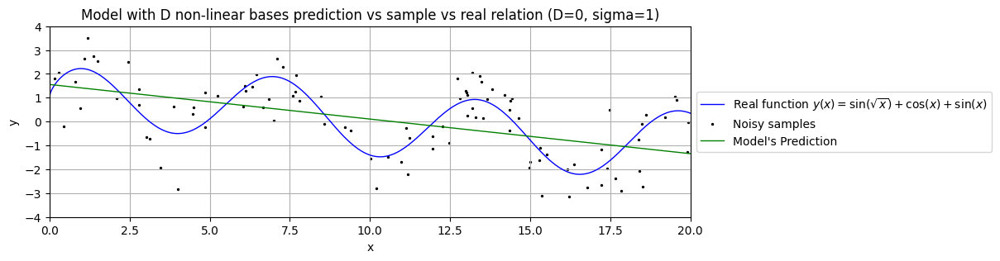

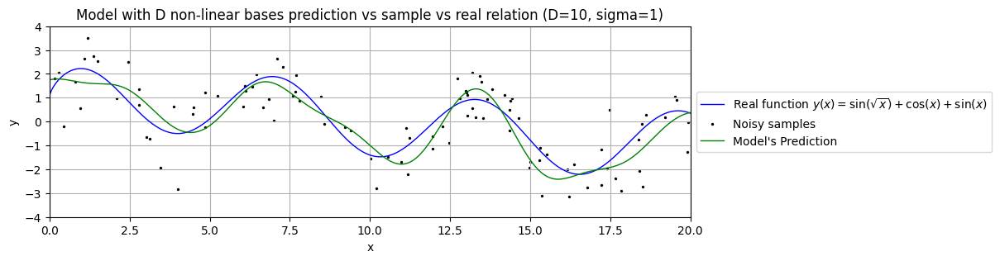

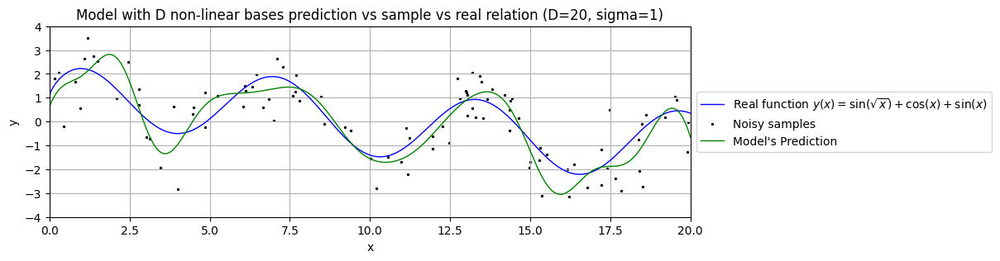

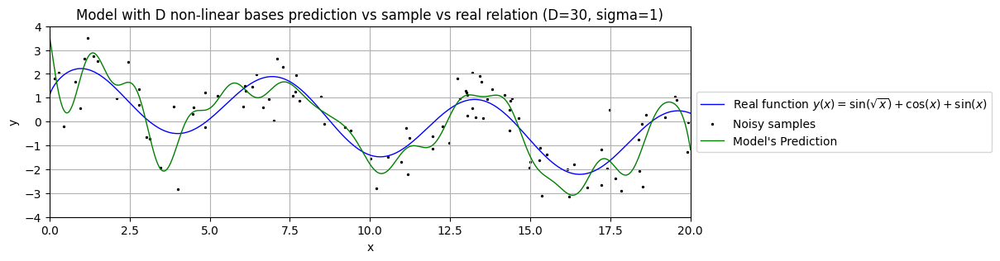

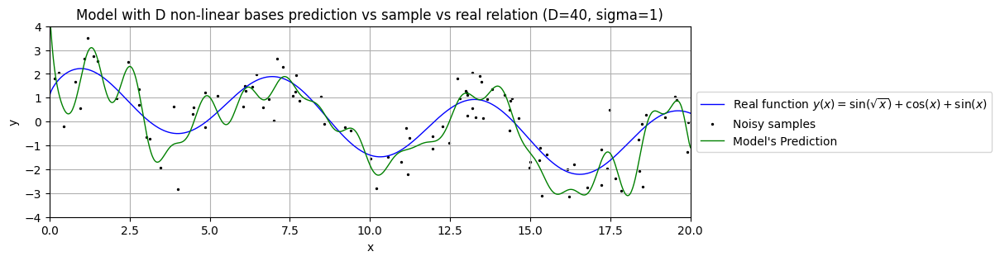

...

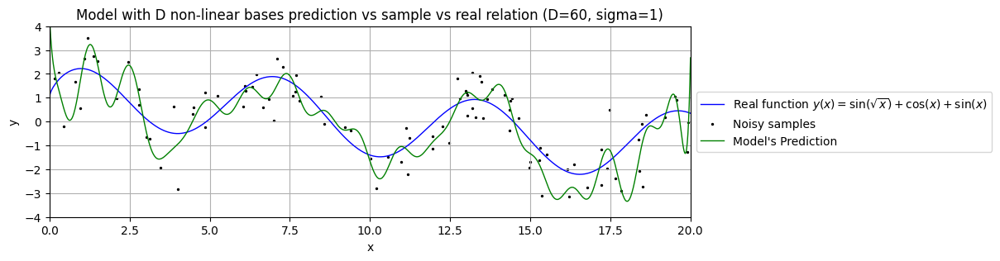

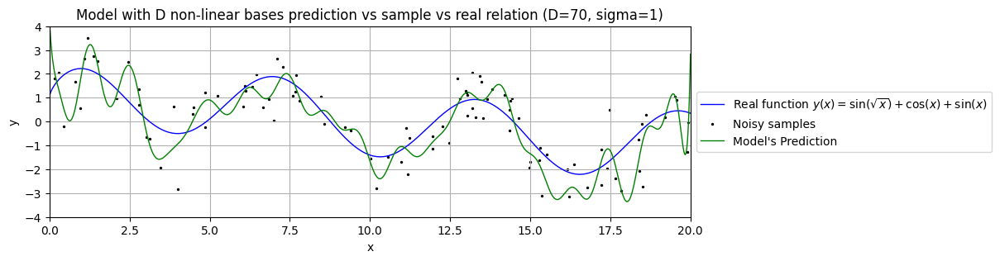

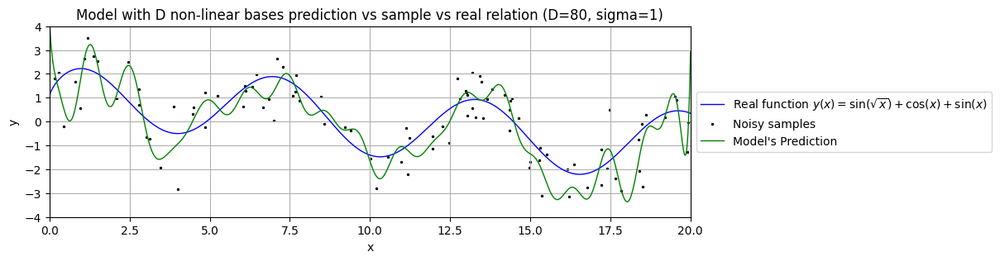

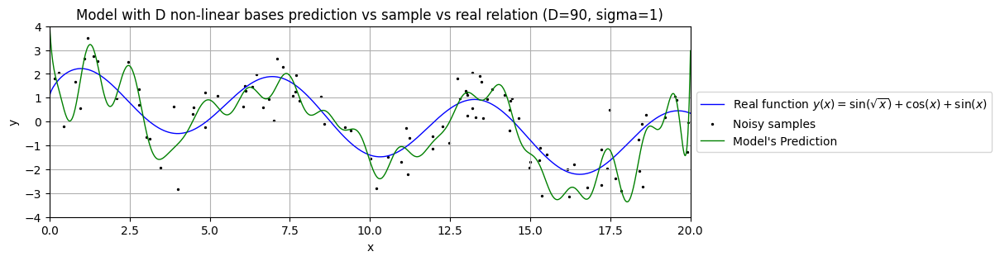

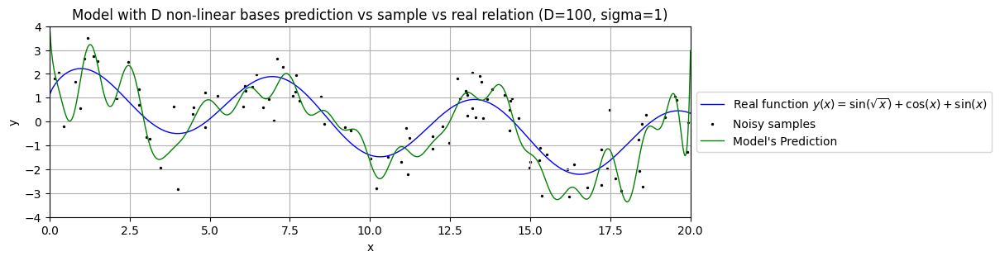

In [83]:
# Plots!
for d in range(0, 101, 10):
  plot_models(x_sample, y_sample, d, 1)


In [84]:
#### 1.4. Model Selection:

In [85]:
# Train - validation split
split_index = 20
x_val, x_train = x_sample[:split_index], x_sample[split_index:]
y_val, y_train = y_sample[:split_index], y_sample[split_index:]

In [86]:
# Sum square error
def sum_squared_error(y_true, y_pred):
  return np.sum((y_true - y_pred) ** 2)

In [88]:
# obtaining SSE table from fiting on train and predicting on validation
def sum_squared_error_table(x_train, y_train, x_val, y_val, sigma = 1.0):
  results = []
  for d in range(0, 101, 10):
    model = fitted_model(x_train, y_train, d, sigma)
    if d == 0:
      y_val_hat = model.predict(x_val)
      y_train_hat = model.predict(x_train)
    else:
      means = np.linspace(0, 20, d)
      y_val_hat = model.predict(design_matrix(x_val, means, sigma))
      y_train_hat = model.predict(design_matrix(x_train, means, sigma))
    sse_t = sum_squared_error(y_train, y_train_hat)
    sse_v = sum_squared_error(y_val, y_val_hat)
    results.append({'Non-Linear Bases (D)': d, 'Training SSE': sse_t, 'Validation SSE': sse_v})
  results_df = pd.DataFrame(results)
  return results_df


In [89]:
# Print table
sse_table = sum_squared_error_table(x_train, y_train, x_val, y_val)
print(sse_table)

    Non-Linear Bases (D)  Training SSE  Validation SSE
0                      0    168.364466       41.375557
1                     10     67.783628       30.954045
2                     20     46.850580       29.002656
3                     30     40.578939       27.481673
4                     40     30.458473       94.384960
5                     50     30.345280      111.050800
6                     60     30.347226      115.914522
7                     70     30.352996      115.547418
8                     80     30.355376      115.503299
9                     90     30.356365      115.249606
10                   100     30.356975      115.281311


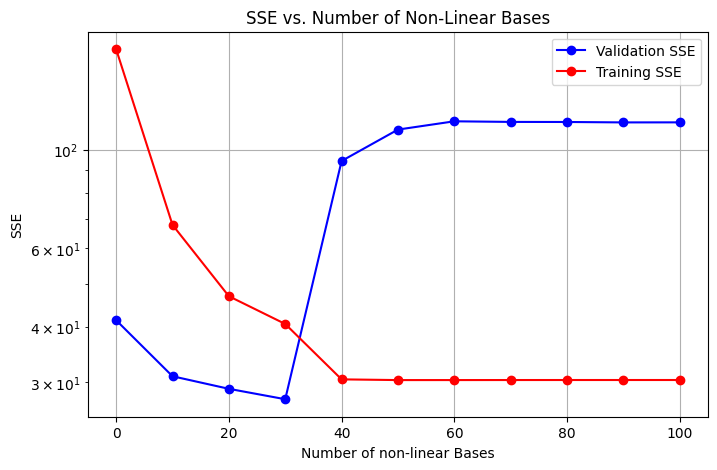

In [90]:
# Plot of table
def plot_validation_sse(results_df, task_two = False):
  if task_two:
    D_values = results_df.index
  else:
    D_values = results_df['Non-Linear Bases (D)']
  validation_sse = results_df['Validation SSE']
  training_sse = results_df['Training SSE']

  plt.figure(figsize=(8, 5))
  if task_two:
    plt.plot(D_values, validation_sse, marker='o', linestyle='-', color='b', label='Average Validation SSE')
    plt.plot(D_values, training_sse, marker='o', linestyle='-', color='r', label='Average Training SSE')
  else:
    plt.plot(D_values, validation_sse, marker='o', linestyle='-', color='b', label='Validation SSE')
    plt.plot(D_values, training_sse, marker='o', linestyle='-', color='r', label='Training SSE')

  plt.xlabel('Number of non-linear Bases')
  plt.ylabel('SSE')
  plt.yscale('log')
  plt.title('SSE vs. Number of Non-Linear Bases')
  plt.grid(True)
  plt.legend(loc='best')
  plt.show()

plot_validation_sse(sse_table)

In [23]:
##### Task 2: Bias-Variance Tradeoff with Multiple Fits

In [24]:
#### 2.1. Repeating the Process (resampling and respliting):
samples = []
for i in range(10):
  x_sample, y_sample = random_sample(100)
  split_index = 20
  x_validation, x_training = x_sample[:split_index], x_sample[split_index:]
  y_validation, y_training = y_sample[:split_index], y_sample[split_index:]
  sample_chunks = {
    'x_train': x_training,
    'y_train': y_training,
    'x_val': x_validation,
    'y_val': y_validation
  }
  samples.append(sample_chunks)

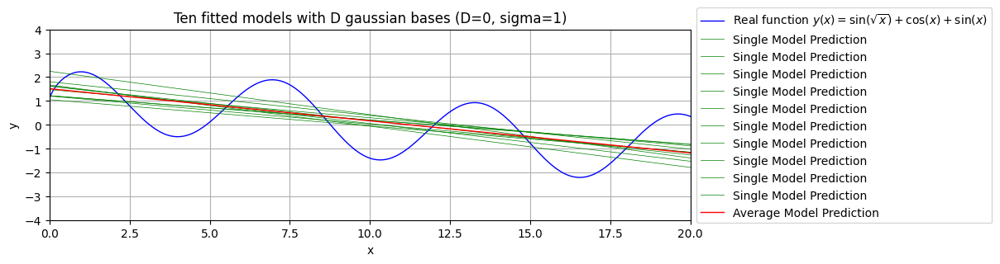

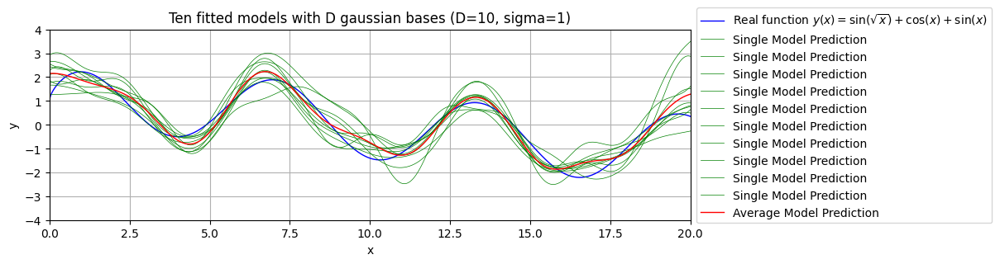

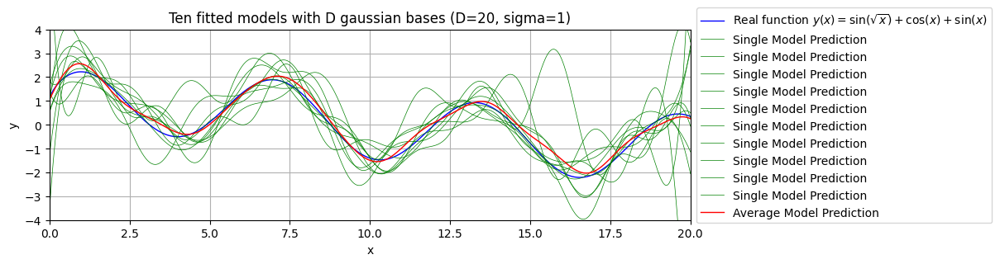

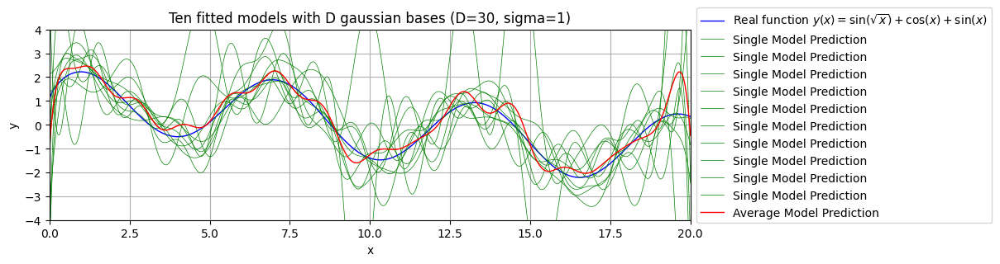

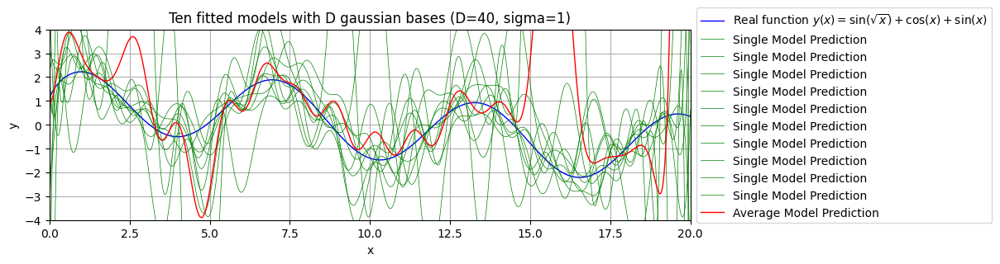

...

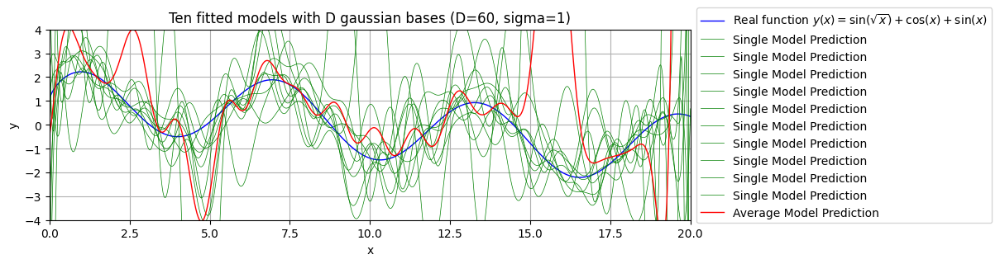

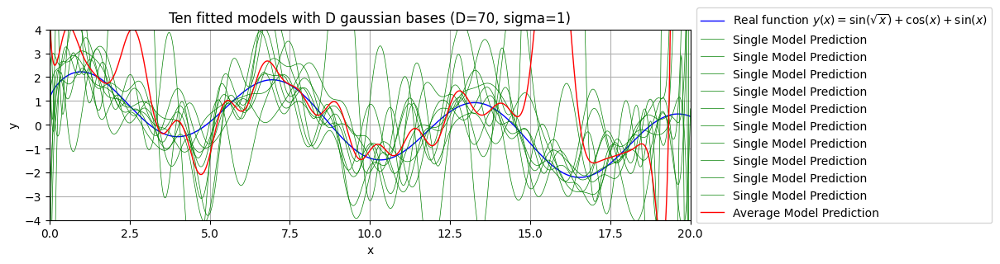

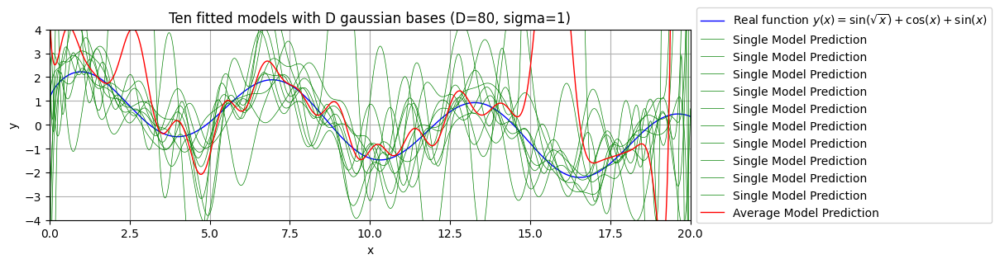

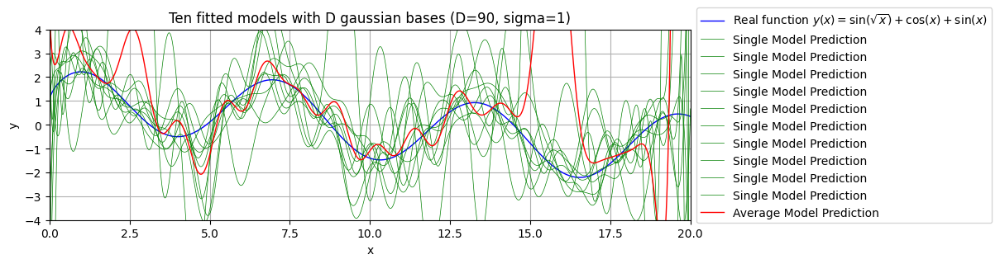

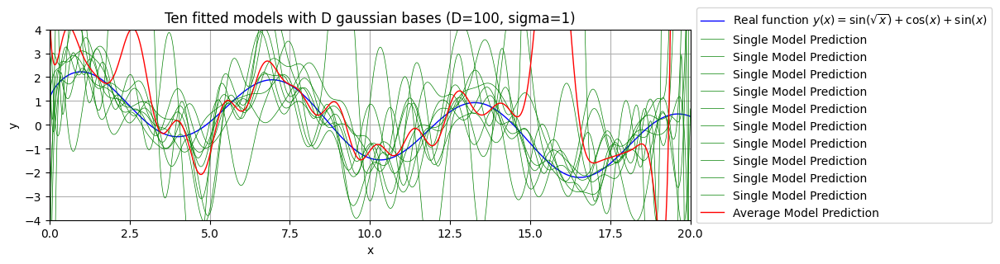

In [25]:
#### 2.2. Plotting Multiple Fits (function that fits and plots and returns error table):
def plot_ten_runs(samples, D, sigma=1.0):
  x_values = np.linspace(0, 20, 1000)

  y_real_values = y_real(x_values)
  predictions = []

  for sample in samples:
    x_train = sample['x_train']
    y_train = sample['y_train']
    model = fitted_model(x_train, y_train, D, sigma)
    if D == 0:
      y_hats = model.predict(x_values)
    else:
      means = np.linspace(0, 20, D)
      y_hats = model.predict(design_matrix(x_values, means, sigma))
    predictions.append(y_hats)
  predictions_array = np.array(predictions)
  average_y = np.mean(predictions_array, axis=0)

  plt.figure(figsize=(10, 3))
  # Plot the real function
  plt.plot(x_real, y_real_values, label="Real function $y(x) = \sin(\sqrt{x}) + \cos(x) + \sin(x)$", color='blue', lw=1)
  # Plot the models's lines
  for prediction in predictions:
    plt.plot(x_values, prediction, label="Single Model Prediction", color="green", lw=0.5)
  # Plot the average model's line
  plt.plot(x_values, average_y, label="Average Model Prediction", color="red", lw=1)

  plt.xlim(0, 20)
  plt.ylim(-4, 4)
  plt.title(f'Ten fitted models with D gaussian bases (D={D}, sigma={sigma})')
  plt.xlabel('x')
  plt.ylabel('y')
  plt.legend(loc='center left', bbox_to_anchor=(1, 0.55))
  plt.grid(True)
  plt.show()

for d in range(0, 101, 10):
  plot_ten_runs(samples, d, 1)

In [26]:
#### 2.3. Plotting Train and Test Errors:
def sum_squared_error_multi_table(samples, sigma = 1.0):
  results = []
  for d in range(0, 101, 10):
    for sample in samples:
      x_train = sample['x_train']
      y_train = sample['y_train']
      x_val = sample['x_val']
      y_val = sample['y_val']
      model = fitted_model(x_train, y_train, d, sigma)
      if d == 0:
        y_val_hat = model.predict(x_val)
        y_train_hat = model.predict(x_train)
      else:
        means = np.linspace(0, 20, d)
        y_val_hat = model.predict(design_matrix(x_val, means, sigma))
        y_train_hat = model.predict(design_matrix(x_train, means, sigma))
      sse_t = sum_squared_error(y_train, y_train_hat)
      sse_v = sum_squared_error(y_val, y_val_hat)
      results.append({'Non-Linear Bases (D)': d, 'Training SSE': sse_t, 'Validation SSE': sse_v})
  results_df = pd.DataFrame(results)
  return results_df

In [27]:
sse_multi_table = sum_squared_error_multi_table(samples)
print(sse_multi_table)

     Non-Linear Bases (D)  Training SSE  Validation SSE
0                       0    145.143645       21.250535
1                       0    191.572687       29.566587
2                       0    173.215308       26.742881
3                       0    165.517011       23.614415
4                       0    172.151194       42.462049
..                    ...           ...             ...
105                   100     38.223685     1546.801767
106                   100     64.352150      151.685622
107                   100     50.776993       63.095919
108                   100     36.729233    18940.280851
109                   100     56.032330      447.894962

[110 rows x 3 columns]


In [28]:
summary_table = sse_multi_table.groupby('Non-Linear Bases (D)')[['Training SSE', 'Validation SSE']].mean()
print(summary_table)

                      Training SSE  Validation SSE
Non-Linear Bases (D)                              
0                       168.677651       34.982049
10                       86.236102       23.289356
20                       68.449256       31.523504
30                       57.999724       51.393447
40                       50.178429     4398.829721
50                       49.797013     4014.831960
60                       49.537544     4844.594186
70                       49.469503     4911.780227
80                       49.460937     4971.716836
90                       49.456849     4981.401283
100                      49.454582     4985.196291


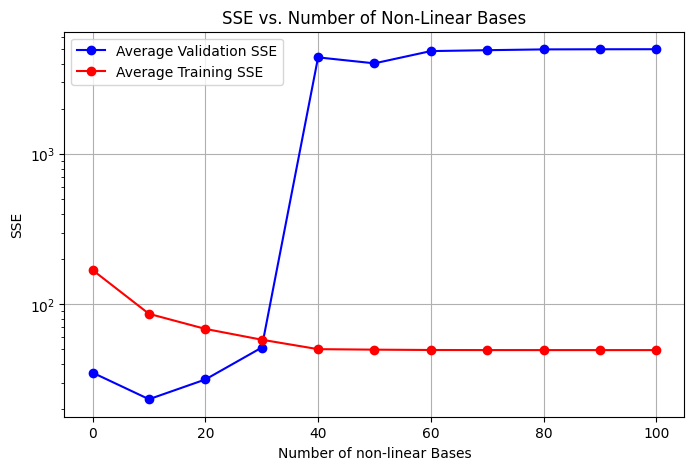

In [29]:
plot_validation_sse(summary_table, True)

In [30]:
##### Task 3: Regularization with Cross-Validation

In [31]:
#### 3.1. Adding Regularization:

In [32]:
# We first create a batch Gradient Descent class for out new regression model as the regularization makes the cost function non-analytic
class GradientDescentBatch:
  def __init__(self, learning_rate = 0.001, max_iters = 1e4, epsilon = 1e-8, record_history=False):
    self.learning_rate = learning_rate
    self.max_iters = max_iters
    self.epsilon = epsilon
    self.record_history = record_history
    if record_history:
      self.w_history = []
  def run(self, gradient, x, y, w):
    grad = np.inf
    t = 1
    while np.linalg.norm(grad) > self.epsilon and t < self.max_iters:
      grad = gradient(x, y, w)
      w = w - self.learning_rate * grad
      if self.record_history:
        self.w_history.append(w)
      t += 1
    return w

In [33]:
# We will employ a mini batch stochastic solution too for runtime issues
class GradientDescentStochasticMiniBatch:
  def __init__(self, learning_rate = 0.001, max_iters = 1e4, epsilon = 1e-8, batch_size = 8, record_history = False):
    self.learning_rate = learning_rate
    self.max_iters = max_iters
    self.epsilon = epsilon
    self.batch_size = batch_size
    self.record_history = record_history
    if record_history:
      self.w_history = []
  def run(self, gradient, x, y, w):
    grad = np.inf
    t = 1
    n_samples = x.shape[0]
    while np.linalg.norm(grad) > self.epsilon and t < self.max_iters:
      batch_indices = np.random.choice(n_samples, self.batch_size, replace=False)
      x_batch = x[batch_indices]
      y_batch = y[batch_indices]
      grad = gradient(x_batch, y_batch, w)
      w = w - self.learning_rate * grad
      if self.record_history:
        self.w_history.append(w)
      t += 1
    return w

In [34]:
# Next we will construct our linear Regression model with L1 or L2 regression
class RegularizedLinearRegression:
  def __init__(self, l_one = False, penalization = 0, biased = True):
      self.biased = biased
      self.penalization = penalization
      self.l_one = l_one
      self.w = None

  def fit(self, X, y, gradient_descent_model):
    if X.ndim == 1:
      X = X[:, None]
      w0 = np.zeros(D)
    N,D = X.shape
    if self.biased:
      X = np.column_stack([np.ones(N), X])
      w0 = np.zeros(D + 1)
    # Gradient Descent solution for L1, Analytical for L2
    if (self.l_one):
      def gradient(X, y, w):
        y_hat = X @ w
        N, D = X.shape
        grad = (0.5 * np.dot(y_hat - y, X) / N) + self.penalization * np.sign(w)
        return grad
      self.w = gradient_descent_model.run(gradient, X, y, w0)
    else:
      #def gradient(X, y, w):
      #  y_hat = X @ w
      #  N, D = X.shape
      #  grad = (0.5 * np.dot(y_hat - y, X) / N) + self.penalization * w
      #  return grad
      N,D = X.shape
      I = np.eye(D)
      lambdaI = self.penalization * I
      self.w = np.linalg.inv(X.T @ X + lambdaI) @ X.T @ y
    return self

  def predict(self, X):
    if X.ndim == 1:
      X = X[:, None]
    if self.biased:
      N = X.shape[0]
      X = np.column_stack([np.ones(N), X])
    y_hat = X @ self.w
    return y_hat

In [35]:
def final_model(x_train, y_train, l_one = False, penalization = 0, learning_rate = 0.001, max_iters = 1e4, epsilon = 1e-8, D = 70, sigma = 1.0):
  gradient_descent = GradientDescentBatch(learning_rate = 0.001, max_iters = 1e4, epsilon = 1e-8)
  if D == 0:
    model = RegularizedLinearRegression(l_one, penalization, True)
    model.fit(x_train, y_train, gradient_descent)
  else:
    means = np.linspace(0, 20, D)
    phi_matrix = design_matrix(x_train, means, sigma)
    model = RegularizedLinearRegression(l_one, penalization, True)
    model.fit(phi_matrix, y_train, gradient_descent)
  return model

In [36]:
#### 3.2. Cross-Validation:

In [37]:
# Our many sample sets and their L fold cross validation splits
L = 10 # We will do L = 10 fold cross validation
N = 20
step = N // L
samples = []
for i in range(50): # We will take 50 sample sets
  folds = []
  x_sample, y_sample = random_sample(N)
  for j in range(0, N, step):
    x_validation = x_sample[j:j+step]
    x_training = np.concatenate((x_sample[:j], x_sample[j+step:]))
    y_validation = y_sample[j:j+step]
    y_training = np.concatenate((y_sample[:j], y_sample[j+step:]))
    sample_chunks = {
      'x_train': x_training,
      'y_train': y_training,
      'x_val': x_validation,
      'y_val': y_validation
    }
    folds.append(sample_chunks)
  samples.append(folds)

In [38]:
# For all hyperparam values
  # For all samples
    # For all folds
def penalization_error_tables(l_one = False, penalizations = [], samples = [], D = 70, sigma = 1.0):
  results = []
  for penalization in penalizations:
    sample_number = 0
    #print(penalization) # for debugging
    for sample in samples:
      sample_number += 1
      split_number = 0
      for split in sample:
        split_number += 1;
        x_train = split['x_train']
        y_train = split['y_train']
        x_val = split['x_val']
        y_val = split['y_val']
        model = final_model(x_train, y_train, l_one = l_one, penalization = penalization, learning_rate = 0.01, max_iters = 1e4, epsilon = 1e-8, D = D, sigma = sigma)
        if D == 0:
          y_val_hat = model.predict(x_val)
          y_train_hat = model.predict(x_train)
        else:
          means = np.linspace(0, 20, D)
          y_val_hat = model.predict(design_matrix(x_val, means, sigma))
          y_train_hat = model.predict(design_matrix(x_train, means, sigma))
        sse_t = sum_squared_error(y_train, y_train_hat)
        sse_v = sum_squared_error(y_val, y_val_hat)
        results.append({'Penalization Parameter': penalization, 'Sample': sample_number, 'Split': split_number, 'Training SSE': sse_t, 'Validation SSE': sse_v})
  results_df = pd.DataFrame(results)
  return results_df

In [39]:
penalizations = np.logspace(-4, 1, 15)
l_one_penalization_error_table = penalization_error_tables(True, penalizations, samples, D = 70, sigma = 1.0)

In [40]:
penalizations2 = np.logspace(-1, 3, 15)
l_two_penalization_error_table = penalization_error_tables(False, penalizations2, samples, D = 70, sigma = 1.0)

In [41]:
#### 3.3. Plotting Train and Test Errors:
l_one_errors_summary = l_one_penalization_error_table.groupby('Penalization Parameter')[['Training SSE', 'Validation SSE']].mean()
l_two_errors_summary = l_two_penalization_error_table.groupby('Penalization Parameter')[['Training SSE', 'Validation SSE']].mean()

In [42]:
print (l_one_errors_summary)

                        Training SSE  Validation SSE
Penalization Parameter                              
0.000100                    9.342586        3.179833
0.000228                    9.356032        3.178179
0.000518                    9.387532        3.174671
0.001179                    9.463741        3.168033
0.002683                    9.658984        3.157072
0.006105                   10.191993        3.143373
0.013895                   11.681900        3.163112
0.031623                   15.816197        3.374281
0.071969                   25.601720        4.020479
0.163789                   39.040290        4.772550
0.372759                   43.682230        4.877937
0.848343                   43.779647        4.866210
1.930698                   43.776320        4.865855
4.393971                   43.775219        4.867043
10.000000                  43.792668        4.865561


In [43]:
print (l_two_errors_summary)

                        Training SSE  Validation SSE
Penalization Parameter                              
0.100000                    5.718097        4.776391
0.193070                    6.245073        4.160059
0.372759                    6.845277        3.733134
0.719686                    7.586285        3.427766
1.389495                    8.607941        3.216603
2.682696                   10.193934        3.106192
5.179475                   12.775735        3.125986
10.000000                  16.718527        3.295299
19.306977                  21.942514        3.587831
37.275937                  27.740082        3.932378
71.968567                  33.088367        4.249989
138.949549                 37.242843        4.492850
268.269580                 40.041729        4.654039
517.947468                 41.740409        4.750868
1000.000000                42.703260        4.805418


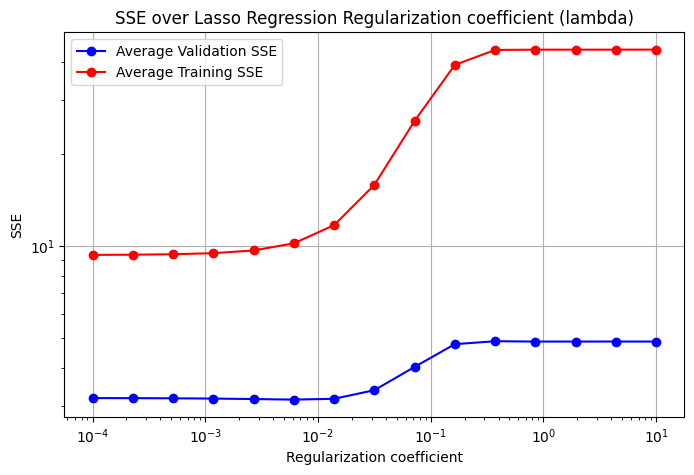

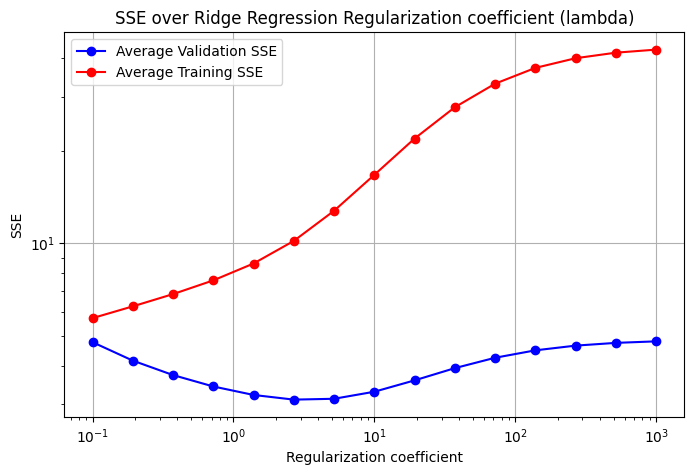

In [44]:
def plot_validation_sse_task3(results_df, lasso = False):
  D_values = results_df.index
  validation_sse = results_df['Validation SSE']
  training_sse = results_df['Training SSE']

  plt.figure(figsize=(8, 5))
  plt.plot(D_values, validation_sse, marker='o', linestyle='-', color='b', label='Average Validation SSE')
  plt.plot(D_values, training_sse, marker='o', linestyle='-', color='r', label='Average Training SSE')

  plt.xlabel('Regularization coefficient')
  plt.xscale('log')
  plt.ylabel('SSE')
  plt.yscale('log')
  if lasso:
    plt.title('SSE over Lasso Regression Regularization coefficient (lambda)')
  else:
    plt.title('SSE over Ridge Regression Regularization coefficient (lambda)')
  plt.grid(True)
  plt.legend(loc='best')
  plt.show()

plot_validation_sse_task3(l_one_errors_summary, True)
plot_validation_sse_task3(l_two_errors_summary)

In [45]:
#### 3.4. Plotting Bias-Variance Decomposition:

In [46]:
def penalization_prediction_tables(l_one = False, penalizations = [], samples = [], D = 70, sigma = 1.0):
  predictions = []
  for penalization in penalizations:
    sample_number = 0
    for sample in samples:
      sample_number += 1
      sample_index = 0
      for split in sample:
        x_train = split['x_train']
        y_train = split['y_train']
        x_val = split['x_val']
        y_val = split['y_val']
        model = final_model(x_train, y_train, l_one = l_one, penalization = penalization, learning_rate = 0.01, max_iters = 1e4, epsilon = 1e-8, D = D, sigma = sigma)
        if D == 0:
          y_val_hat = model.predict(x_val)
        else:
          means = np.linspace(0, 20, D)
          y_val_hat = model.predict(design_matrix(x_val, means, sigma))
        for i in range(len(y_val)):
          sample_index += 1
          predictions.append({'Penalization Parameter': penalization, 'Sample': sample_number, 'Sample index': sample_index, 'x': x_val[i], 'y_val': y_val[i], 'y_hat': y_val_hat[i]})
  predictions_df = pd.DataFrame(predictions)
  return predictions_df

In [47]:
lasso_prediction_table = penalization_prediction_tables(True, penalizations, samples, D = 70, sigma = 1.0)

In [48]:
ridge_prediction_table = penalization_prediction_tables(False, penalizations2, samples, D = 70, sigma = 1.0)

In [49]:
average_lasso_predictions = lasso_prediction_table.groupby(['Penalization Parameter', 'Sample index'])['y_hat'].mean().reset_index()
average_lasso_predictions.rename(columns={'y_hat': 'y_bar'}, inplace=True)
lasso_prediction_table = pd.merge(lasso_prediction_table, average_lasso_predictions, on=['Penalization Parameter', 'Sample index'])
lasso_prediction_table['y_real'] = lasso_prediction_table['x'].apply(y_real)

In [50]:
average_ridge_predictions = ridge_prediction_table.groupby(['Penalization Parameter', 'Sample index'])['y_hat'].mean().reset_index()
average_ridge_predictions.rename(columns={'y_hat': 'y_bar'}, inplace=True)
ridge_prediction_table = pd.merge(ridge_prediction_table, average_ridge_predictions, on=['Penalization Parameter', 'Sample index'])
ridge_prediction_table['y_real'] = ridge_prediction_table['x'].apply(y_real)

In [51]:
lasso_prediction_table['bias'] = (lasso_prediction_table['y_bar'] - lasso_prediction_table['y_real'])
lasso_prediction_table['variance'] = (lasso_prediction_table['y_hat'] - lasso_prediction_table['y_bar']) ** 2
lasso_prediction_table['se'] = (lasso_prediction_table['y_hat'] - lasso_prediction_table['y_val']) ** 2

In [52]:
ridge_prediction_table['bias'] = (ridge_prediction_table['y_bar'] - ridge_prediction_table['y_real'])
ridge_prediction_table['variance'] = (ridge_prediction_table['y_hat'] - ridge_prediction_table['y_bar']) ** 2
ridge_prediction_table['se'] = (ridge_prediction_table['y_hat'] - ridge_prediction_table['y_val']) ** 2

In [53]:
lasso_variance_helper = lasso_prediction_table.groupby(['Penalization Parameter', 'Sample'])['variance'].mean().reset_index()
lasso_variance_helper.rename(columns={'variance': 'Variance'}, inplace=True)

lasso_bias_helper = lasso_prediction_table.groupby(['Penalization Parameter', 'Sample'])['bias'].mean().reset_index() # should be the same in each row but we average anyway
lasso_bias_helper.rename(columns={'bias': 'Bias'}, inplace=True)
lasso_bias_helper['Bias^2'] = lasso_bias_helper['Bias'] ** 2

lasso_mse_helper = lasso_prediction_table.groupby(['Penalization Parameter', 'Sample'])['se'].mean().reset_index()
lasso_mse_helper.rename(columns={'se': 'MSE'}, inplace=True)

lasso_overall_biassqr = lasso_bias_helper.groupby(['Penalization Parameter'])['Bias^2'].mean().reset_index()
lasso_overall_variance = lasso_variance_helper.groupby(['Penalization Parameter'])['Variance'].mean().reset_index()
lasso_overall_mse = lasso_mse_helper.groupby(['Penalization Parameter'])['MSE'].mean().reset_index()

lasso_errors = pd.merge(lasso_overall_biassqr, lasso_overall_variance, on='Penalization Parameter')
lasso_errors = pd.merge(lasso_errors, lasso_overall_mse, on='Penalization Parameter')

lasso_errors['Bias^2 + Variance'] = lasso_errors['Variance'] + lasso_errors['Bias^2']

In [54]:
ridge_variance_helper = ridge_prediction_table.groupby(['Penalization Parameter', 'Sample'])['variance'].mean().reset_index()
ridge_variance_helper.rename(columns={'variance': 'Variance'}, inplace=True)

ridge_bias_helper = ridge_prediction_table.groupby(['Penalization Parameter', 'Sample'])['bias'].mean().reset_index() # should be the same in each row but we av anyway
ridge_bias_helper.rename(columns={'bias': 'Bias'}, inplace=True)
ridge_bias_helper['Bias^2'] = ridge_bias_helper['Bias'] ** 2

ridge_mse_helper = ridge_prediction_table.groupby(['Penalization Parameter', 'Sample'])['se'].mean().reset_index()
ridge_mse_helper.rename(columns={'se': 'MSE'}, inplace=True)

ridge_overall_biassqr = ridge_bias_helper.groupby(['Penalization Parameter'])['Bias^2'].mean().reset_index()
ridge_overall_variance = ridge_variance_helper.groupby(['Penalization Parameter'])['Variance'].mean().reset_index()
ridge_overall_mse = ridge_mse_helper.groupby(['Penalization Parameter'])['MSE'].mean().reset_index()

ridge_errors = pd.merge(ridge_overall_biassqr, ridge_overall_variance, on='Penalization Parameter')
ridge_errors = pd.merge(ridge_errors, ridge_overall_mse, on='Penalization Parameter')

ridge_errors['Bias^2 + Variance'] = ridge_errors['Variance'] + ridge_errors['Bias^2']

In [55]:
print(lasso_errors)
print(ridge_errors)

    Penalization Parameter    Bias^2  Variance       MSE  Bias^2 + Variance
0                 0.000100  0.074867  1.393919  1.589916           1.468787
1                 0.000228  0.074871  1.388692  1.589089           1.463563
2                 0.000518  0.074880  1.376928  1.587336           1.451808
3                 0.001179  0.074901  1.350708  1.584016           1.425609
4                 0.002683  0.074962  1.293672  1.578536           1.368634
5                 0.006105  0.075146  1.173942  1.571687           1.249087
6                 0.013895  0.075524  0.945681  1.581556           1.021205
7                 0.031623  0.076383  0.592443  1.687141           0.668826
8                 0.071969  0.078360  0.222239  2.010239           0.300599
9                 0.163789  0.079484  0.030911  2.386275           0.110396
10                0.372759  0.081781  0.000503  2.438969           0.082284
11                0.848343  0.082133  0.000002  2.433105           0.082135
12          

In [56]:
def plot_generalization_error(error_table, lasso = False):
  lambdas = error_table['Penalization Parameter']
  variances = error_table['Variance']
  bias_squareds = error_table['Bias^2']
  mses = error_table['MSE']
  sum_bias_variance = error_table['Bias^2 + Variance']

  plt.figure(figsize=(10, 5))
  plt.plot(lambdas, variances, linestyle='-', color='blue', label='Variance')
  plt.plot(lambdas, bias_squareds, linestyle='-', color='red', label='Bias^2')
  plt.plot(lambdas, sum_bias_variance, linestyle='-', color='purple', label='Bias^2 + Variance')
  plt.plot(lambdas, mses, linestyle='-', color='green', label='Bias^2 + Variance + noise = MSE')

  plt.xlabel('Regularization coefficient (lambda)')
  plt.xscale('log')
  plt.ylabel('SSE')
  #plt.yscale('log')
  if lasso:
    plt.title('Error breakdown over Lasso Regression Regularization coefficient (lambda)')
  else:
    plt.title('Error breakdown over Ridge Regression Regularization coefficient (lambda)')
  plt.grid(True)
  plt.legend(loc='best')
  plt.show()

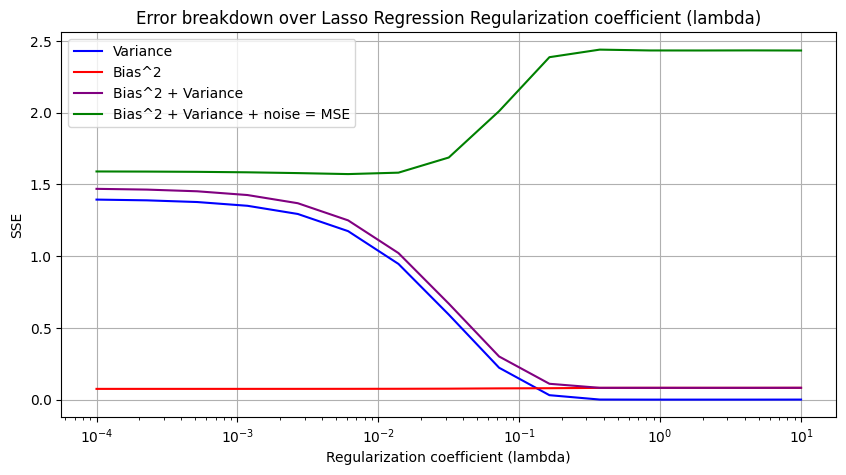

In [57]:
plot_generalization_error(lasso_errors, lasso = True)

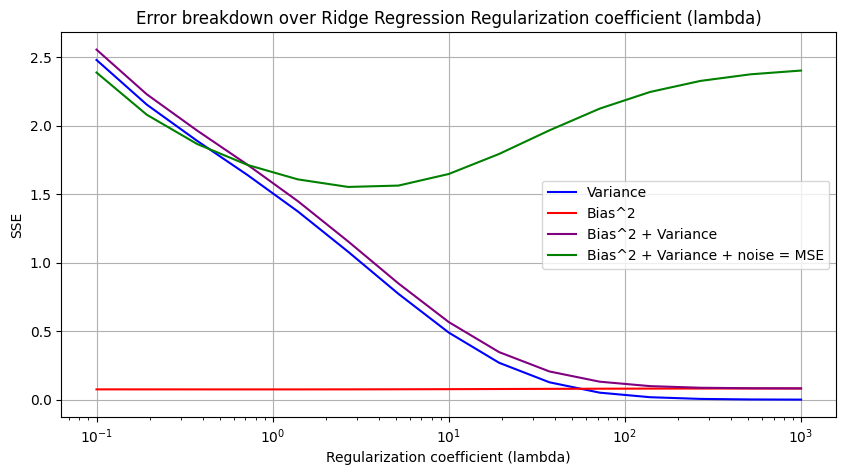

In [58]:
plot_generalization_error(ridge_errors)

In [59]:
## 4.1: Generating Synthetic Data

In [60]:
# 2nd Relation Function
def y_real2(x):
    return -4*x + 10

# Generating data points
def random_sample2(number_of_samples = 100):
  # 100 random x values as a vector
  x_values = np.random.uniform(0, 10, number_of_samples)
  # Associated real y values
  y_values = y_real2(x_values)
  # Adding Gaussian Noise vector
  noise = np.random.normal(0, 1, number_of_samples)
  # Combining
  y_noisy = y_values + 2*noise
  # return
  return x_values, y_noisy

x_sample2, y_sample2 = random_sample2(50)

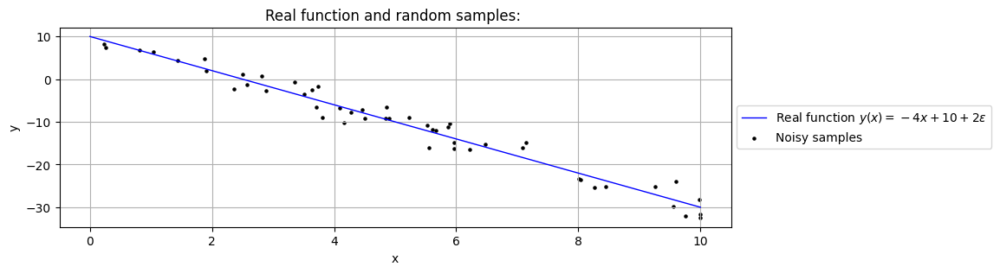

In [61]:
# Plot

x_real2 = np.linspace(0, 10, 1000)
y_real2_values = y_real2(x_real2)
plt.figure(figsize=(10, 3))

# Plot the real function
plt.plot(x_real2, y_real2_values, label="Real function $y(x) = -4x + 10 + 2\epsilon $", color='blue', lw=1)

# Plot the noisy samples
plt.scatter(x_sample2, y_sample2, label="Noisy samples", color='black', marker='o', s = 5)

# Add titles and labels
plt.title("Real function and random samples: ")
plt.xlabel("x")
plt.ylabel("y")
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.grid(True)

# Show plot
plt.show()

In [62]:
## 4.2 Applying L1 and L2 Regularization: Implement Ridge and Lasso regression using GradientDescent

In [63]:
## From class, L2 Regularization
class GradientDescent:

    def __init__(self, learning_rate=.001, max_iters=1e4, epsilon=1e-8, record_history=False):
        self.learning_rate = learning_rate
        self.max_iters = max_iters
        self.record_history = record_history
        self.epsilon = epsilon

        if record_history:
            self.w_history = []

    def run(self, gradient_fn, x, y, w):
        grad = np.inf
        t = 1

        while np.linalg.norm(grad) > self.epsilon and t < self.max_iters:

            grad = gradient_fn(x, y, w)
            w = w - self.learning_rate * grad

            if self.record_history:
                self.w_history.append(w)

            t += 1

        return w

# L1 Regularization
class L1LinearRegression:
    def __init__(self, add_bias=True, l1_reg=0):
        self.add_bias = add_bias
        self.l1_reg = l1_reg
        pass

    def fit(self, x, y, optimizer):

        if x.ndim == 1:
            x = x[:, None]

        if self.add_bias:
            N = x.shape[0]
            x = np.column_stack([x,np.ones(N)])

        N,D = x.shape
        def gradient(x, y, w):
            yh =  x @ w
            N, D = x.shape
            grad = .5*np.dot(yh - y, x)/N
            grad += self.l1_reg * np.sign(w) # Only difference
            return grad

        w0 = np.zeros(D)
        self.w = optimizer.run(gradient, x, y, w0)
        return self

    def predict(self, x):
        if self.add_bias:
            x = np.column_stack([x,np.ones(N)])
        yh = x@self.w
        return yh


# L2 Regularization
class L2LinearRegression:
    def __init__(self, add_bias=True, l2_reg=0):
        self.add_bias = add_bias
        self.l2_reg = l2_reg
        pass

    def fit(self, x, y, optimizer):

        if x.ndim == 1:
            x = x[:, None]

        if self.add_bias:
            N = x.shape[0]
            x = np.column_stack([x,np.ones(N)])

        N,D = x.shape
        def gradient(x, y, w):
            yh =  x @ w
            N, D = x.shape
            grad = .5*np.dot(yh - y, x)/N
            grad += self.l2_reg * w # Only difference
            return grad

        w0 = np.zeros(D)
        self.w = optimizer.run(gradient, x, y, w0)
        return self

    def predict(self, x):
        if self.add_bias:
            x = np.column_stack([x,np.ones(N)])
        yh = x@self.w
        return yh

In [64]:
## 4.3: Plotting the Loss Function

In [65]:
# To plot the contours
def plot_contour(f, x1bound, x2bound, resolution, ax):
    x1range = np.linspace(x1bound[0], x1bound[1], resolution)
    x2range = np.linspace(x2bound[0], x2bound[1], resolution)
    xg, yg = np.meshgrid(x1range, x2range)
    zg = np.zeros_like(xg)
    for i,j in itertools.product(range(resolution), range(resolution)):
        zg[i,j] = f([xg[i,j], yg[i,j]])
    ax.contour(xg, yg, zg, 100)
    return ax

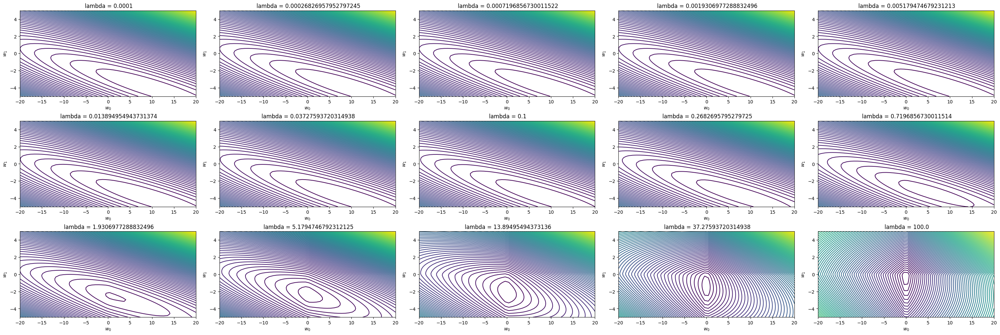

In [66]:
## L1 Loss:
cost = lambda w, reg: .5*np.mean((w[0] + w[1]*x_sample2 - y_sample2)**2) + reg*np.sum(np.abs(w))

reg_list = np.logspace(-4, 2, 15)
#reg_list = [0, 1, 10]
fig, axes = plt.subplots(ncols=5, nrows=3, constrained_layout=True, figsize=(30, 10))

j = -1

for i, reg_coef in enumerate(reg_list):
    if i%5 == 0:
        j+= 1

    current_cost = lambda w: cost(w, reg_coef)
    plot_contour(current_cost, [-20,20], [-5,5], 50, axes[j][i % 5])
    axes[j][i % 5].set_xlabel(r'$w_0$')
    axes[j][i % 5].set_ylabel(r'$w_1$')
    axes[j][i % 5].set_title(f' lambda = {reg_coef}')
    axes[j][i % 5].set_xlim([-20,20])
    axes[j][i % 5].set_ylim([-5,5])
plt.show()

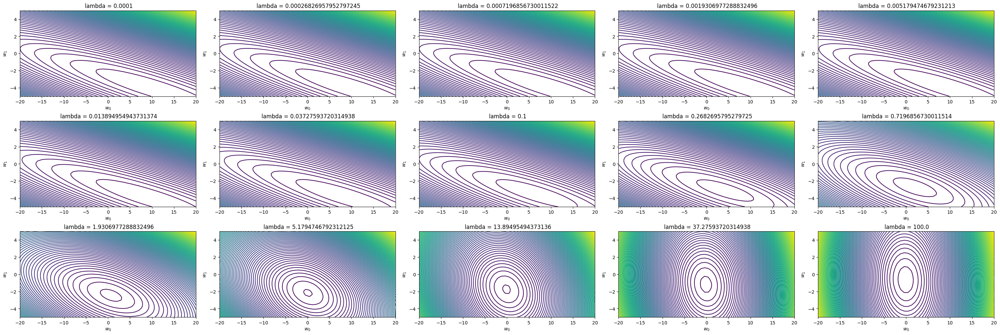

In [67]:
## L2 Cost Function:
cost = lambda w, reg: .5*np.mean((w[0] + w[1]*x_sample2 - y_sample2)**2) + reg*np.dot(w,w)/2

reg_list = np.logspace(-4, 2, 15)
#reg_list = [0, 1, 10]
fig, axes = plt.subplots(ncols=5, nrows=3, constrained_layout=True, figsize=(30, 10))

j = -1

for i, reg_coef in enumerate(reg_list):
    if i%5 == 0:
        j+= 1

    current_cost = lambda w: cost(w, reg_coef)
    plot_contour(current_cost, [-20,20], [-5,5], 50, axes[j][i % 5])
    axes[j][i % 5].set_xlabel(r'$w_0$')
    axes[j][i % 5].set_ylabel(r'$w_1$')
    axes[j][i % 5].set_title(f' lambda = {reg_coef}')
    axes[j][i % 5].set_xlim([-20,20])
    axes[j][i % 5].set_ylim([-5,5])
plt.show()

In [68]:
## 4.4 Vizualizing Gradient Descent

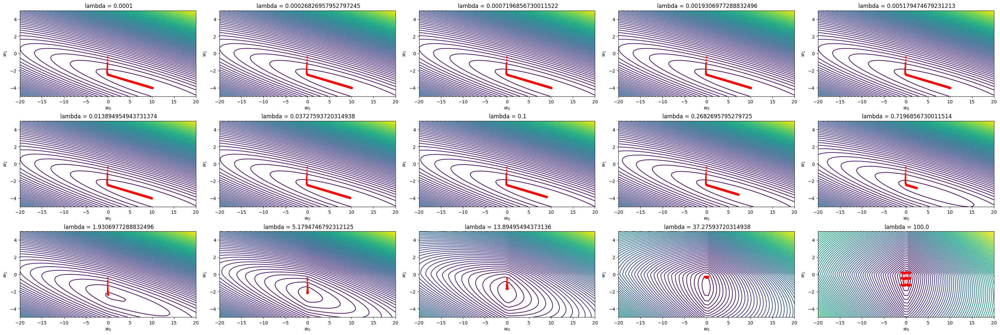

In [69]:
## L1 Cost Function:
cost = lambda w, reg: .5*np.mean((w[0] + w[1]*x_sample2 - y_sample2)**2) + reg*np.sum(np.abs(w))

reg_list = np.logspace(-4, 2, 15)
#reg_list = [0, 1, 10]
fig, axes = plt.subplots(ncols=5, nrows=3, constrained_layout=True, figsize=(30, 10))

j = -1

for i, reg_coef in enumerate(reg_list):
    if i%5 == 0:
        j+= 1

    optimizer = GradientDescent(learning_rate=.01, max_iters=1e4, record_history=True)
    model = L1LinearRegression(optimizer, l1_reg=reg_coef)
    model.fit(x_sample2,y_sample2, optimizer)
    current_cost = lambda w: cost(w, reg_coef)
    plot_contour(current_cost, [-20,20], [-5,5], 50, axes[j][i % 5])
    w_hist = np.vstack(optimizer.w_history) # T x 2
    axes[j][i % 5].plot(w_hist[:,1], w_hist[:,0], '.r', alpha=.8)
    axes[j][i % 5].plot(w_hist[:,1], w_hist[:,0], '-r', alpha=.3)
    axes[j][i % 5].set_xlabel(r'$w_0$')
    axes[j][i % 5].set_ylabel(r'$w_1$')
    axes[j][i % 5].set_title(f' lambda = {reg_coef}')
    axes[j][i % 5].set_xlim([-20,20])
    axes[j][i % 5].set_ylim([-5,5])
plt.show()

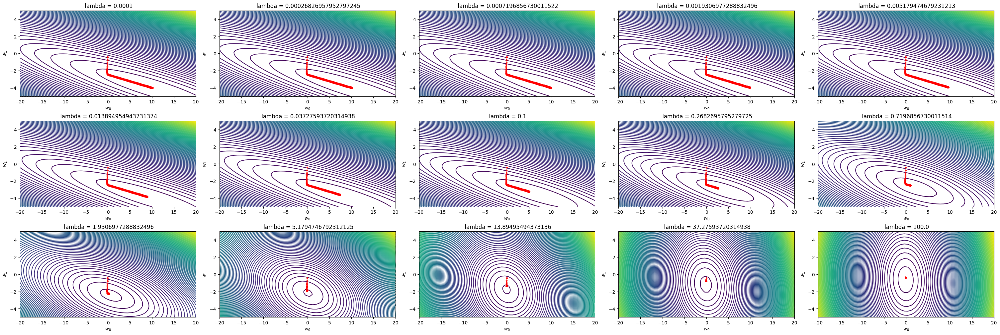

In [70]:
## L2 Cost Function:
cost = lambda w, reg: .5*np.mean((w[0] + w[1]*x_sample2 - y_sample2)**2) + reg*np.dot(w,w)/2

reg_list = np.logspace(-4, 2, 15)
#reg_list = [0, 1, 10]
fig, axes = plt.subplots(ncols=5, nrows=3, constrained_layout=True, figsize=(30, 10))

j = -1

for i, reg_coef in enumerate(reg_list):
    if i%5 == 0:
        j+= 1


    optimizer = GradientDescent(learning_rate=.01, max_iters=1e4, record_history=True)
    model = L2LinearRegression(optimizer, l2_reg=reg_coef)
    model.fit(x_sample2,y_sample2, optimizer)
    current_cost = lambda w: cost(w, reg_coef)
    plot_contour(current_cost, [-20,20], [-5,5], 50, axes[j][i % 5])
    w_hist = np.vstack(optimizer.w_history) # T x 2
    axes[j][i % 5].plot(w_hist[:,1], w_hist[:,0], '.r', alpha=.8)
    axes[j][i % 5].plot(w_hist[:,1], w_hist[:,0], '-r', alpha=.3)
    axes[j][i % 5].set_xlabel(r'$w_0$')
    axes[j][i % 5].set_ylabel(r'$w_1$')
    axes[j][i % 5].set_title(f' lambda = {reg_coef}')
    axes[j][i % 5].set_xlim([-20,20])
    axes[j][i % 5].set_ylim([-5,5])
plt.show()